Vasmos a cargar el dataset de AirBnB descargado de [aquí](https://public.opendatasoft.com/explore/dataset/airbnb-listings/export/?disjunctive.host_verifications&disjunctive.amenities&disjunctive.features&q=Madrid&dataChart=eyJxdWVyaWVzIjpbeyJjaGFydHMiOlt7InR5cGUiOiJjb2x1bW4iLCJmdW5jIjoiQ09VTlQiLCJ5QXhpcyI6Imhvc3RfbGlzdGluZ3NfY291bnQiLCJzY2llbnRpZmljRGlzcGxheSI6dHJ1ZSwiY29sb3IiOiJyYW5nZS1jdXN0b20ifV0sInhBeGlzIjoiY2l0eSIsIm1heHBvaW50cyI6IiIsInRpbWVzY2FsZSI6IiIsInNvcnQiOiIiLCJzZXJpZXNCcmVha2Rvd24iOiJyb29tX3R5cGUiLCJjb25maWciOnsiZGF0YXNldCI6ImFpcmJuYi1saXN0aW5ncyIsIm9wdGlvbnMiOnsiZGlzanVuY3RpdmUuaG9zdF92ZXJpZmljYXRpb25zIjp0cnVlLCJkaXNqdW5jdGl2ZS5hbWVuaXRpZXMiOnRydWUsImRpc2p1bmN0aXZlLmZlYXR1cmVzIjp0cnVlfX19XSwidGltZXNjYWxlIjoiIiwiZGlzcGxheUxlZ2VuZCI6dHJ1ZSwiYWxpZ25Nb250aCI6dHJ1ZX0%3D&location=16,41.38377,2.15774&basemap=jawg.streets)

![](descargar.png)

In [42]:
# install.packages("vctrs", repos = "http://cran.us.r-project.org")
library(tidyverse)
library(ggplot2)
library(ggthemes)
library(dendextend)
library(cluster)


In [43]:
airbnb<-read.csv('../data/airbnb-listings.csv',sep = ';')
options(repr.plot.height=4,repr.plot.width=6,repr.plot.res = 300)

Vamos a quedarnos con las columnas de mayor interés:

'City','Room.Type','Neighbourhood','Accommodates','Bathrooms','Bedrooms','Beds','Price','Square.Feet','Guests.Included','Extra.People','Review.Scores.Rating','Latitude', 'Longitude'

In [44]:
selected_columns <- c('City', 'Room.Type', 'Neighbourhood', 'Accommodates', 'Bathrooms', 'Bedrooms', 'Beds', 'Price', 'Square.Feet', 'Guests.Included', 'Extra.People', 'Review.Scores.Rating', 'Latitude', 'Longitude')
airbnb <- airbnb[, selected_columns]
airbnb

City,Room.Type,Neighbourhood,Accommodates,Bathrooms,Bedrooms,Beds,Price,Square.Feet,Guests.Included,Extra.People,Review.Scores.Rating,Latitude,Longitude
<chr>,<chr>,<chr>,<int>,<dbl>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>,<dbl>
Madrid,Entire home/apt,,2,1.0,0,1,50,NA,2,15,96,40.40745,-3.7079955
Madrid,Entire home/apt,,4,1.0,1,2,50,NA,2,25,81,40.40832,-3.7050064
Madrid,Entire home/apt,,4,1.5,1,2,77,NA,1,0,89,40.41372,-3.7068231
Madrid,Entire home/apt,Embajadores,2,1.0,1,2,50,NA,1,20,93,40.41126,-3.6973054
Madrid,Entire home/apt,Embajadores,5,1.0,2,4,95,NA,4,0,97,40.41256,-3.7011554
Madrid,Entire home/apt,La Latina,4,1.0,1,2,69,NA,2,18,91,40.40791,-3.7050954
Madrid,Entire home/apt,,2,1.0,1,1,70,NA,1,0,100,40.40898,-3.6982515
Madrid,Private room,La Latina,2,1.5,1,1,30,NA,1,0,80,40.40836,-3.7040433
Madrid,Entire home/apt,Embajadores,4,1.0,1,2,57,NA,2,8,98,40.41162,-3.7032811


Nos quedarmos solo con las entradas de Madrid para Room.Type=="Entire home/apt" y cuyo barrio (Neighbourhood) no está vacio ''
Podemos eliminar las siguientes columnas que ya no son necesarias:
"Room.Type",'City'

Llama a nuevo dataframe df_madrid.

In [45]:
num_initial_entries <- nrow(airbnb)
cat("Number of initial entries:", num_initial_entries, "\n")

df_madrid <- airbnb %>% 
                filter(City == "Madrid") %>% 
                filter(Room.Type == "Entire home/apt") %>% 
                filter(Neighbourhood != '') %>% 
                filter(!is.na(Neighbourhood)) %>%
                select(-c('Room.Type','City'))

num_filtered_entries <- nrow(df_madrid)
cat("Number of entries after filtering: ", num_filtered_entries)

Number of initial entries: 14780 
Number of entries after filtering:  5601

Crea una nueva columna llamada Square.Meters a partir de Square.Feet. Recuerda que un pie cuadrado son 0.092903 metros cuadrados.

In [46]:
df_madrid <- df_madrid %>% 
                mutate(Square.Meters = Square.Feet*0.092903) %>% 
                select(-Square.Feet)

df_madrid %>% head()

,Neighbourhood,Accommodates,Bathrooms,Bedrooms,Beds,Price,Guests.Included,Extra.People,Review.Scores.Rating,Latitude,Longitude,Square.Meters
,<chr>,<int>,<dbl>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>
1,Embajadores,2,1,1,2,50,1,20,93,40.41126,-3.697305,NA
2,Embajadores,5,1,2,4,95,4,0,97,40.41256,-3.701155,NA
3,La Latina,4,1,1,2,69,2,18,91,40.40791,-3.705095,NA
4,Embajadores,4,1,1,2,57,2,8,98,40.41162,-3.703281,NA
5,La Latina,2,1,1,1,59,1,0,95,40.40734,-3.707019,NA
6,La Latina,14,2,3,14,120,2,18,92,40.40908,-3.704744,NA


¿Que porcentaje de los apartamentos no muestran los metros cuadrados? Es decir, ¿cuantos tienen NA en Square.Meters?

In [47]:
# Find the total number of apartments
n_apartments <- nrow(df_madrid)

# Print the total number of apartments
print(paste('Total number of apartments: ', n_apartments))

# Find the number of apartments with Square.Meters = NA
n_apartments_m2NA <- df_madrid %>% filter(is.na(Square.Meters)) %>% nrow()

# Print the number of apartments with Square.Meters = NA
print(paste('Number of apartments with Square.Meters = NA: ', n_apartments_m2NA))

# Print the percentage of apartments with Square.Meters = NA
print(paste('Percentage of apartments with Square.Meters = NA: ', n_apartments_m2NA/n_apartments))

[1] "Total number of apartments:  5601"
[1] "Number of apartments with Square.Meters = NA:  5254"
[1] "Percentage of apartments with Square.Meters = NA:  0.938046777361185"


De todos los apartamentos que tienen un valor de metros cuadrados diferente de NA 
¿Que porcentaje de los apartamentos tienen 0 metros cuadrados?

In [48]:
# Find the number of apartments with Square.Meters not equal to NA
n_apartments_m2_notNA <- df_madrid %>% filter(!is.na(Square.Meters)) %>% nrow()

# Print the number of apartments with Square.Meters not equal to NA
print(paste('Number of apartments with Square.Meters not equal to NA: ', n_apartments_m2_notNA))

# Find the number of apartments with Square.Meters equal to 0
n_apartments_m2_0 <- df_madrid %>% filter(Square.Meters == 0) %>% nrow()

# Print the number of apartments with Square.Meters equal to 0
print(paste('Number of apartments with Square.Meters equal to 0: ', n_apartments_m2_0))

# Print the percentage of apartments with Square.Meters equal to 0
print(paste('Percentage of apartments with Square.Meters equal to 0: ', n_apartments_m2_0 / n_apartments_m2_notNA))


[1] "Number of apartments with Square.Meters not equal to NA:  347"
[1] "Number of apartments with Square.Meters equal to 0:  128"
[1] "Percentage of apartments with Square.Meters equal to 0:  0.368876080691643"


Reemplazar todos los 0m^2 por NA 

In [49]:
# Replace the values of Square.Meters that are equal to 0 with NA
df_madrid$Square.Meters[df_madrid$Square.Meters == 0] <- NA


Son muchos, vamos a intentar crear un modelo que nos prediga cuantos son los metros cuadrados en función del resto de variables para tratar de rellenar esos NA. Pero **antes de crear el modelo** vamos a hacer:
* pintar el histograma de los metros cuadrados y ver si tenemos que filtrar algún elemento más.
* crearemos una variable sintética nueva basada en la similitud entre barrios que usaremos en nuestro modelo.

Pinta el histograma de los metros cuadrados y ver si tenemos que filtrar algún elemento más

In [50]:
library(plotly)


# give it a theme
plot_ly(data = df_madrid, x = ~Square.Meters, type = 'histogram', nbinsx = 20, xbins = list(start = 0, end = 600, size = 20)) %>% layout(title = 'Histogram of Square.Meters', xaxis = list(title = 'Square.Meters'), yaxis = list(title = 'Count'), bargap = 0.05)


HTML widgets cannot be represented in plain text (need html)

Asigna el valor NA a la columna Square.Meters de los apartamentos que tengan menos de 20 m^2

In [51]:
df_madrid$Square.Meters[df_madrid$Square.Meters < 20] <- NA

Existen varios Barrios que todas sus entradas de Square.Meters son NA, vamos a eliminar del dataset todos los pisos que pertenecen a estos barrios.

In [52]:
# Group the data frame by neighborhood and count the number of Square.Meters values that are not NA.
# If a neighborhood has no Square.Meters values that are not NA, it should be removed.
df_group_neighborhoods <- df_madrid %>% 
  group_by(Neighbourhood) %>%
  summarise("Number of apartments with Square.Meters != NA" = sum(!is.na(Square.Meters)))

# Select only neighborhoods that have at least one Square.Meters value that is not NA
df_neighborhoods_without_m2_NA <- df_group_neighborhoods %>% 
  filter(`Number of apartments with Square.Meters != NA` > 0) %>%
  select(Neighbourhood)

# Convert the list of neighborhoods from a tibble to a vector
neighborhoods_without_m2_NA <- df_neighborhoods_without_m2_NA$Neighbourhood

# Select only those neighborhoods from the original data frame
df_madrid <- df_madrid %>%
  filter(Neighbourhood %in% neighborhoods_without_m2_NA)

  df_madrid


Neighbourhood,Accommodates,Bathrooms,Bedrooms,Beds,Price,Guests.Included,Extra.People,Review.Scores.Rating,Latitude,Longitude,Square.Meters
<chr>,<int>,<dbl>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>
Embajadores,2,1,1,2,50,1,20,93,40.41126,-3.697305,NA
Embajadores,5,1,2,4,95,4,0,97,40.41256,-3.701155,NA
La Latina,4,1,1,2,69,2,18,91,40.40791,-3.705095,NA
Embajadores,4,1,1,2,57,2,8,98,40.41162,-3.703281,NA
La Latina,2,1,1,1,59,1,0,95,40.40734,-3.707019,NA
La Latina,14,2,3,14,120,2,18,92,40.40908,-3.704744,NA
La Latina,2,1,1,1,89,1,10,98,40.41007,-3.710624,NA
Palacio,5,3,3,3,192,2,12,80,40.42017,-3.712629,NA
La Latina,4,1,1,1,100,2,12,NA,40.40990,-3.710948,NA


In [53]:
# Print the number of unique neighborhoods and the number of rows in the df_madrid data frame
print(paste('After filtering, there are', 
            n_distinct(df_madrid$Neighbourhood), 
            'neighborhoods and', 
            nrow(df_madrid), 
            'entries'))


[1] "After filtering, there are 38 neighborhoods and 4901 entries"


El barrio parece ser un indicador importante para los metros cuadrados de un apartamento.

Vamos a agrupar los barrios por metros cuadrados. Podemos usar una matriz de similaridad de Tukey tal y como hicimos en el curso de estadística:

In [54]:
library(plotly)
# could not find melt
library(reshape2)
# Perform Tukey's honest significant difference test
tky <- TukeyHSD(aov(formula = Square.Meters ~ Neighbourhood, data = df_madrid))

# Extract the test results
tky_result <- data.frame(tky$Neighbourhood)

# Sort the unique neighborhoods
cn <- sort(unique(df_madrid$Neighbourhood))

# Create a matrix to store the test results
resm <- matrix(NA, length(cn), length(cn))
rownames(resm) <- cn
colnames(resm) <- cn

# Fill in the matrix with the test results
resm[lower.tri(resm)] <- round(tky_result$p.adj, 4)
resm[upper.tri(resm)] <- t(resm)[upper.tri(resm)] 
diag(resm) <- 1

# Melt the matrix into a data frame
dfResm <- melt(resm)

# Create the plot
plot_ly(data = dfResm, x = ~Var1, y = ~Var2, type = 'heatmap', z = ~value, colorscale = 'Viridis') %>% 
  layout(xaxis = list(title = 'Class'), yaxis = list(title = 'Class'), title = 'Tukey\'s honest significant difference test')


HTML widgets cannot be represented in plain text (need html)

Usando como variable de distancia: 1-resm
Dibuja un dendrograma de los diferentes barrios.


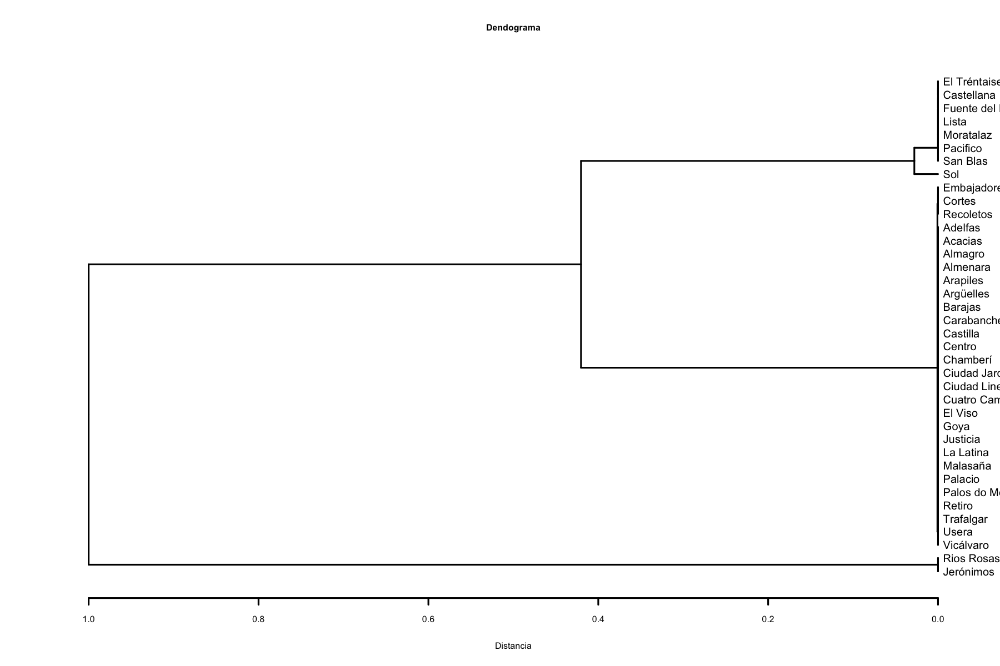

In [55]:
# Calculo de matriz de distancias
d <- as.dist(1-resm)
hc <- hclust(d,method="complete")
#hc <- hclust(d,method="average")
# hc <- hclust(d,method="centroid")

hcd <- as.dendrogram(hc)
par(cex=0.4)
plot(hcd, horiz=TRUE, main="Dendograma", xlab="Distancia", sub="", cex.lab=0.8, cex.axis=0.8, cex.main=0.8, cex.sub=0.8)


¿Que punto de corte sería el aconsejable?, ¿cuantos clusters aparecen?

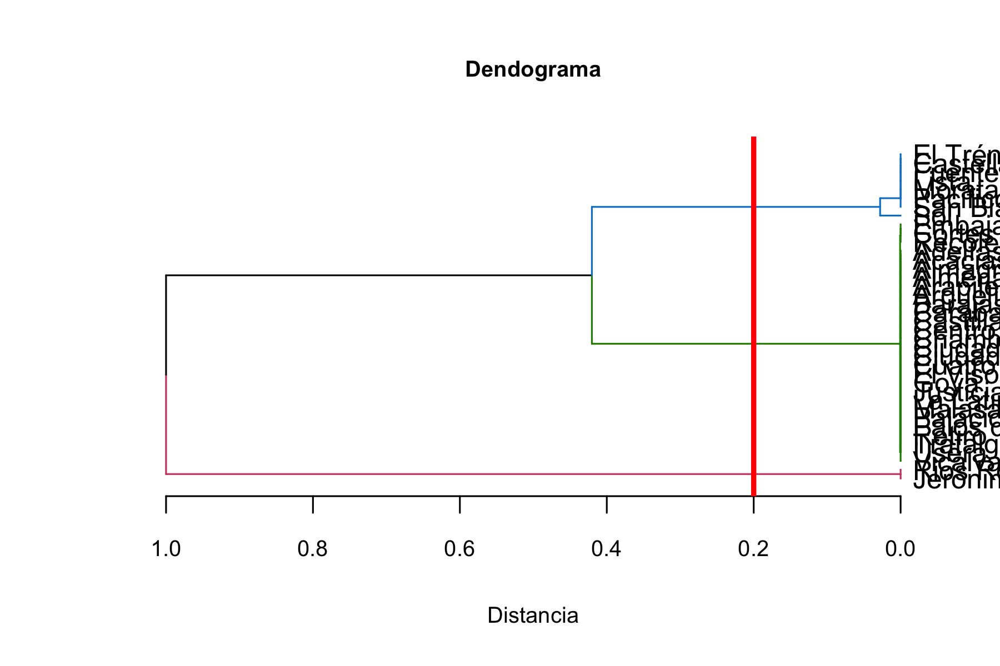

In [56]:
library(dendextend)

# Cut the dendrogram at 0.2, creating 3 clusters
h_cut = 0.2

# Plot the dendrogram with colored branches
plot(color_branches(hcd, h = h_cut), horiz = TRUE, cex = 0.4, 
     main = "Dendograma", xlab = "Distancia", sub = "", 
     cex.lab = 0.8, cex.axis = 0.8, cex.main = 0.8, cex.sub = 0.8)
     

# Add a vertical line at the cut point
abline(v = h_cut, col = "red", lwd = 3)


In [57]:
# Create a list with the cluster ID for each neighborhood
Group_n <- cutree_1h.dendrogram(hcd, h = h_cut)
#Group_n <- cutree(hcd, k = 3)

# Create a data frame with the name of each neighborhood and the cluster ID (neighb_id) it belongs to
df_neighb_id <- data.frame(Neighbourhood = df_neighborhoods_without_m2_NA, neighb_id = Group_n)

# Add a column to df_madrid indicating the cluster to which each apartment belongs based on the neighborhood
df_madrid <- merge(x = df_madrid, y = df_neighb_id, by = "Neighbourhood")
df_madrid


Neighbourhood,Accommodates,Bathrooms,Bedrooms,Beds,Price,Guests.Included,Extra.People,Review.Scores.Rating,Latitude,Longitude,Square.Meters,neighb_id
<chr>,<int>,<dbl>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<int>
Acacias,4,1,2,2,45,2,25,89,40.40068,-3.704121,NA,2
Acacias,2,1,0,1,39,1,0,100,40.40094,-3.702806,NA,2
Acacias,2,1,0,1,22,1,5,97,40.40504,-3.705093,NA,2
Acacias,4,1,3,3,60,2,10,91,40.40563,-3.710020,NA,2
Acacias,2,1,2,1,75,1,0,NA,40.40270,-3.703143,NA,2
Acacias,2,1,1,1,68,1,0,94,40.40452,-3.707737,NA,2
Acacias,2,1,1,1,60,1,0,80,40.40030,-3.701024,NA,2
Acacias,6,1,2,3,50,2,10,68,40.40226,-3.712753,NA,2
Acacias,2,1,1,1,35,1,0,96,40.40057,-3.702002,NA,2


In [58]:
df_madrid$Neighbourhood <- as.factor(df_madrid$Neighbourhood)
df_madrid$neighb_id <- as.factor(df_madrid$neighb_id)

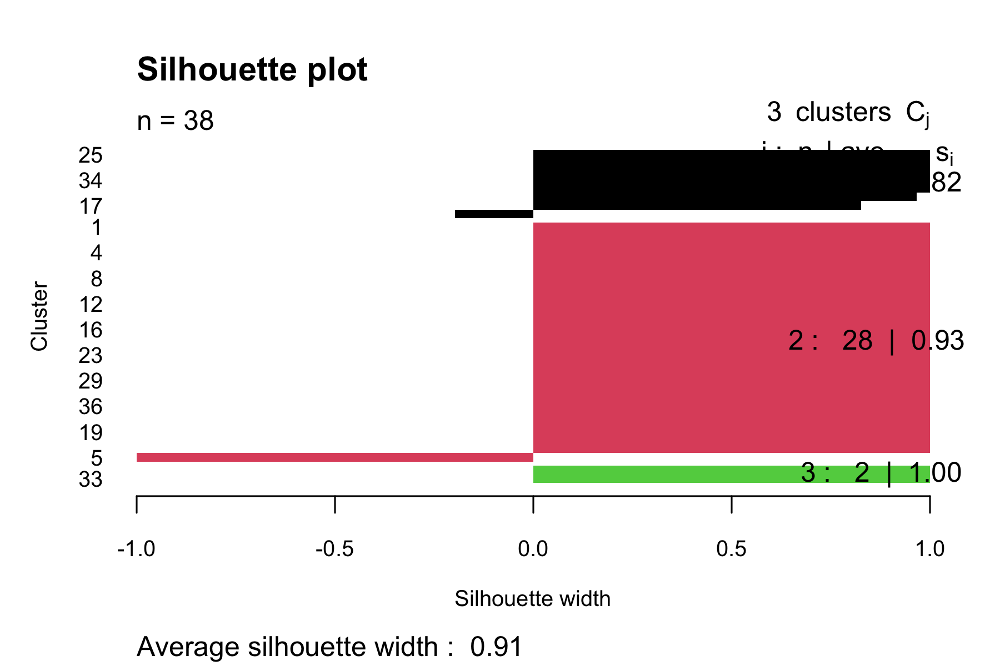

In [83]:
# Calculate the silhouette scores for each cluster
ss <- silhouette(Group_n, d)

# Plot the silhouette scores, coloring each cluster with a different color
plot(ss, col = 1:max(Group_n), border = NA, 
     main = "Silhouette plot", xlab = "Silhouette width", ylab = "Cluster", 
# make text smaller to fit in the plot
     cex.main = 0.8, cex.lab = 0.8, cex.axis = 0.8 , 
     # make plot larger
     mar = c(5, 5, 5, 5), cex = 0.8)


In [60]:
# Use only entries that have a Square.Meters value != NA
df_madrid_noNA <- df_madrid %>% filter(!is.na(Square.Meters))
paste("There are", df_madrid_noNA %>% nrow(), "entries with Square.Meters != NA:")

# Create test and train groups
set.seed(26)
idx <- sample(1:nrow(df_madrid_noNA), nrow(df_madrid_noNA) * 0.7)

df_madrid_noNA.train <- df_madrid_noNA[idx, ]
df_madrid_noNA.test <- df_madrid_noNA[-idx, ]
paste("The train group has", nrow(df_madrid_noNA.train), "entries")
paste("The test group has", nrow(df_madrid_noNA.test), "entries")


[1] "There are 174 entries with Square.Meters != NA:"

[1] "The train group has 121 entries"

[1] "The test group has 53 entries"

In [61]:
# Fit a linear regression model to the training data
model_madrid <- lm(Square.Meters ~ Accommodates + Bathrooms + Bedrooms +
                    Beds + Price + Guests.Included + Extra.People +
                    Review.Scores.Rating + neighb_id,
                    data = df_madrid_noNA.train)

# View a summary of the model
summary(model_madrid)



Call:
lm(formula = Square.Meters ~ Accommodates + Bathrooms + Bedrooms + 
    Beds + Price + Guests.Included + Extra.People + Review.Scores.Rating + 
    neighb_id, data = df_madrid_noNA.train)

Residuals:
    Min      1Q  Median      3Q     Max 
-46.312 -10.593  -2.135   8.867  64.143 

Coefficients:
                      Estimate Std. Error t value Pr(>|t|)    
(Intercept)          -24.50771   25.47316  -0.962  0.33821    
Accommodates           1.64427    2.12061   0.775  0.43986    
Bathrooms             25.35800    5.86784   4.322 3.53e-05 ***
Bedrooms              15.40864    3.22262   4.781 5.70e-06 ***
Beds                   0.04684    2.15486   0.022  0.98270    
Price                  0.05751    0.03295   1.745  0.08385 .  
Guests.Included       -5.91839    1.94713  -3.040  0.00299 ** 
Extra.People           0.35799    0.20835   1.718  0.08871 .  
Review.Scores.Rating   0.44835    0.25676   1.746  0.08371 .  
neighb_id2           -10.85888    4.52385  -2.400  0.01814 *  
nei

In [62]:
# Fit a linear regression model to the training data
model_madrid <- lm(Square.Meters ~ Bathrooms + Bedrooms + Extra.People + neighb_id,
                    data = df_madrid_noNA.train)

# View a summary of the model
summary(model_madrid)



Call:
lm(formula = Square.Meters ~ Bathrooms + Bedrooms + Extra.People + 
    neighb_id, data = df_madrid_noNA.train)

Residuals:
    Min      1Q  Median      3Q     Max 
-59.546 -10.811  -1.948   9.151  81.223 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   21.2259     7.5535   2.810 0.005831 ** 
Bathrooms     19.1467     5.1279   3.734 0.000296 ***
Bedrooms      16.3341     2.7204   6.004 2.34e-08 ***
Extra.People   0.3425     0.1975   1.734 0.085545 .  
neighb_id2    -9.3736     4.6890  -1.999 0.047981 *  
neighb_id3   268.7267    25.5944  10.499  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 20.35 on 114 degrees of freedom
  (1 observation deleted due to missingness)
Multiple R-squared:  0.8365,	Adjusted R-squared:  0.8293 
F-statistic: 116.7 on 5 and 114 DF,  p-value: < 2.2e-16


Mirad el histograma de los residuos sobre el conjunto de test para evaluar la calidad de vuestro modelo

In [63]:
# Calculate residuals using the test group
df_madrid_noNA.train$m2_est <- predict(model_madrid, df_madrid_noNA.train)

# Plot the actual values of Square.Meters against the predicted values
# plot(df_madrid_noNA.train$Square.Meters,(df_madrid_noNA.train$Square.Meters-df_madrid_noNA.train$m2_est))



#  use plotly
library(plotly)
plot_ly(df_madrid_noNA.train, x = ~Square.Meters, y = ~m2_est, type = 'scatter', mode = 'markers', color = ~m2_est) %>% 
  layout(xaxis = list(title = 'Square.Meters'), yaxis = list(title = 'm2_est'), title = 'Square.Meters vs m2_est')



HTML widgets cannot be represented in plain text (need html)

In [64]:
# Calculate and display the model performance
caret::postResample(pred=df_madrid_noNA.train$m2_est, obs= df_madrid_noNA.train$Square.Meters)
# add to plot 
plot_ly(df_madrid_noNA.train, x = ~Square.Meters, y = ~m2_est, type = 'scatter', mode = 'markers', color = ~m2_est) %>% 
  layout(xaxis = list(title = 'Square.Meters'), yaxis = list(title = 'm2_est'), title = 'Square.Meters vs m2_est') %>% 
  add_trace(x = df_madrid_noNA.train$Square.Meters, y = df_madrid_noNA.train$Square.Meters, mode = 'lines', name = 'y=x')
# suppress messages and warning
options(warn=-1, message=-1)

RMSE   Rsquared        MAE 
19.8381505  0.8365149 14.2054843

HTML widgets cannot be represented in plain text (need html)

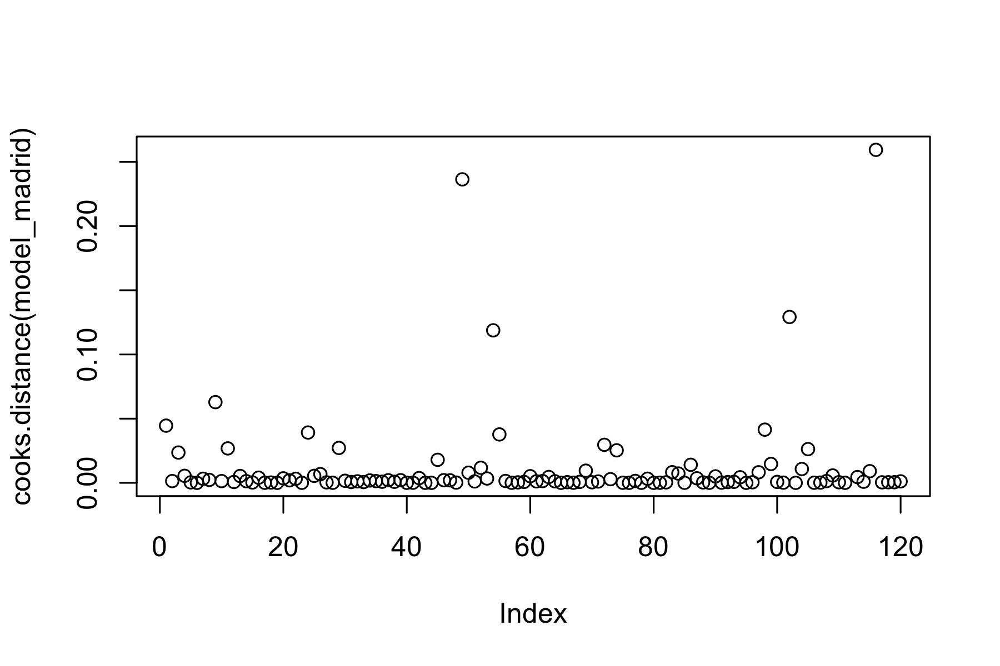

In [65]:
# Graphical representation of the Cook's distance
plot(cooks.distance(model_madrid))


In [76]:
# plot the histogram of the residuals with plotly

library(plotly)
plot_ly(df_madrid_noNA.train, x = ~m2_est, y = ~Square.Meters, type = 'histogram', color = ~m2_est) %>% 
  layout(xaxis = list(title = 'm2_est'), yaxis = list(title = 'Square.Meters'), title = 'Histogram of the residuals') %>%
    add_trace(x = df_madrid_noNA.train$m2_est, y = df_madrid_noNA.train$Square.Meters, mode = 'lines', name = 'y=x')    %>%
    # do not show abo the 100 m2 est
     add_trace(x = df_madrid_noNA.train$m2_est, y = df_madrid_noNA.train$Square.Meters, mode = 'lines', name = 'y=x', xaxis = 'x2', yaxis = 'y2') %>%
        layout(xaxis2 = list(title = 'm2_est', range = c(0, 100)), yaxis2 = list(title = 'Square.Meters', range = c(0, 100))) 
        

HTML widgets cannot be represented in plain text (need html)

Si tuvieramos un anuncio de un apartamento para 6 personas (Accommodates), con 1 baño, con un precio de 80€/noche y 3 habitaciones en el barrio de Sol, con 3 camas y un review de 80.
¿Cuantos metros cuadrados tendría? Si tu modelo necesita algúna variable adicional puedes inventartela dentro del rango de valores del dataset.
¿Como varía sus metros cuadrados con cada habitación adicional?

In [28]:
# Determine which group of Neighbourhood the Sol neighborhood belongs to
df_neighb_id[df_neighb_id$Neighbourhood == "Sol", "neighb_id"]


[1] 1

In [29]:
# Calculate the predicted size of the room using the model_madrid model
predicted_size <- predict(model_madrid, 
                          data.frame(Bathrooms = 1, 
                                     Bedrooms = 3, 
                                     Extra.People = 2, 
                                     neighb_id = as.factor(1)))

# Round the predicted size to 2 decimal places and create a string with the result
result_string <- paste("The room would have", round(predicted_size, digits = 2), "m2")

# Print the result string
print(result_string)


[1] "The room would have 90.06 m2"


In [30]:
# Extract the coefficient for the Bedrooms variable from the model summary
bedrooms_coef <- summary(model_madrid)$coefficients["Bedrooms","Estimate"]

# Round the coefficient to 2 decimal places
rounded_coef <- round(bedrooms_coef, digits = 2)

# Create a string with the result
result_string <- paste("With each additional bedroom, the square meters increase:", rounded_coef, "m2")

# Print the result string
print(result_string)


[1] "With each additional bedroom, the square meters increase: 16.33 m2"


Rellenar los Square.Meters con valor NA con el estimado con el modelo anterior.

In [31]:
# Select rows from df_madrid where Square.Meters is NA
df_madrid_1 <- df_madrid[is.na(df_madrid$Square.Meters),]

# Select rows from df_madrid where Square.Meters is not NA
df_madrid_2 <- df_madrid[!is.na(df_madrid$Square.Meters),]

In [32]:
# Use the model_madrid model to calculate Square.Meters for rows where it is NA
df_madrid_1[,"Square.Meters"] <- predict(model_madrid, data.frame(
    Bathrooms=df_madrid_1$Bathrooms,
    Bedrooms=df_madrid_1$Bedrooms,
    Extra.People=df_madrid_1$Extra.People,
    neighb_id=df_madrid_1$neighb_id))

# Combine the data frame with the calculated values of Square.Meters with the data frame with the actual values
df_madrid <- rbind(df_madrid_1, df_madrid_2)
df_madrid


,Neighbourhood,Accommodates,Bathrooms,Bedrooms,Beds,Price,Guests.Included,Extra.People,Review.Scores.Rating,Latitude,Longitude,Square.Meters,neighb_id
,<fct>,<int>,<dbl>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<fct>
1,Acacias,4,1.0,2,2,45,2,25,89,40.40068,-3.704121,72.23027,2
2,Acacias,2,1.0,0,1,39,1,0,100,40.40094,-3.702806,30.99897,2
3,Acacias,2,1.0,0,1,22,1,5,97,40.40504,-3.705093,32.71160,2
4,Acacias,4,1.0,3,3,60,2,10,91,40.40563,-3.710020,83.42641,2
5,Acacias,2,1.0,2,1,75,1,0,NA,40.40270,-3.703143,63.66708,2
6,Acacias,2,1.0,1,1,68,1,0,94,40.40452,-3.707737,47.33302,2
7,Acacias,2,1.0,1,1,60,1,0,80,40.40030,-3.701024,47.33302,2
8,Acacias,6,1.0,2,3,50,2,10,68,40.40226,-3.712753,67.09236,2
9,Acacias,2,1.0,1,1,35,1,0,96,40.40057,-3.702002,47.33302,2


Usar PCA para encontrar el apartamento más cercano a uno dado.

Este algoritmo nos ayudaría a dado un apartamento que el algoritmo nos devolvería los 5 apartamentos más similares.


Crearemos una función tal que le pasemos un apartamento con los siguientes datos:
* Accommodates	
* Bathrooms	
* Bedrooms	
* Beds	
* Price	
* Guests.Included	
* Extra.People	
* Review.Scores.Rating	
* Latitude	
* Longitude	
* Square.Meters

y nos devuelva los 5 más similares de:


In [33]:
#Generamos el dataframe con los datos del piso que inventaremos
Accommodates_piso <- 6
Bathrooms_piso <- 2
Bedrooms_piso <- 3
Beds_piso <- 5
Price_piso <- 110
Guests.Included_piso <- 2
Extra.People_piso <-2
Review.Scores.Rating_piso <- 90
Latitude_piso <- 40.47152
Longitude_piso <- -3.715909
Square.Meters_piso <- 120

df_apto_new <- data.frame(Accommodates=Accommodates_piso, 
                          Bathrooms=Bathrooms_piso, 
                          Bedrooms=Bedrooms_piso, 
                          Beds=Beds_piso, 
                          Price=Price_piso, 
                          Guests.Included=Guests.Included_piso, 
                          Extra.People=Extra.People_piso, 
                          Review.Scores.Rating=Review.Scores.Rating_piso, 
                          Latitude=Latitude_piso, 
                          Longitude=Longitude_piso, 
                          Square.Meters=Square.Meters_piso)

df_madrid_aptos <- na.omit(df_madrid[,c('Accommodates'
                                            ,'Bathrooms'
                                            ,'Bedrooms'
                                            ,'Beds'
                                            ,'Price'
                                            ,'Guests.Included'
                                            ,'Extra.People'
                                            ,'Review.Scores.Rating'
                                            ,'Latitude'
                                            ,'Longitude'
                                            ,'Square.Meters')])

In [34]:
#Aplicamos PCA sobre el dataframe de los apartamentos de Madrid
pr_aptos <- prcomp(df_madrid_aptos, center=TRUE, scale.=TRUE)
str(pr_aptos)

List of 5
 $ sdev    : num [1:11] 2.114 1.18 1.026 1.001 0.838 ...
 $ rotation: num [1:11, 1:11] 0.42 0.371 0.41 0.403 0.357 ...
  ..- attr(*, "dimnames")=List of 2
  .. ..$ : chr [1:11] "Accommodates" "Bathrooms" "Bedrooms" "Beds" ...
  .. ..$ : chr [1:11] "PC1" "PC2" "PC3" "PC4" ...
 $ center  : Named num [1:11] 4.13 1.24 1.42 2.38 87.17 ...
  ..- attr(*, "names")= chr [1:11] "Accommodates" "Bathrooms" "Bedrooms" "Beds" ...
 $ scale   : Named num [1:11] 1.9 0.504 0.946 1.524 54.23 ...
  ..- attr(*, "names")= chr [1:11] "Accommodates" "Bathrooms" "Bedrooms" "Beds" ...
 $ x       : num [1:4187, 1:11] -0.148 -2.614 -2.657 0.54 -1.891 ...
  ..- attr(*, "dimnames")=List of 2
  .. ..$ : chr [1:4187] "1" "2" "3" "4" ...
  .. ..$ : chr [1:11] "PC1" "PC2" "PC3" "PC4" ...
 - attr(*, "class")= chr "prcomp"


[1] "The sum of variance of the first 5 components is:  78.3"

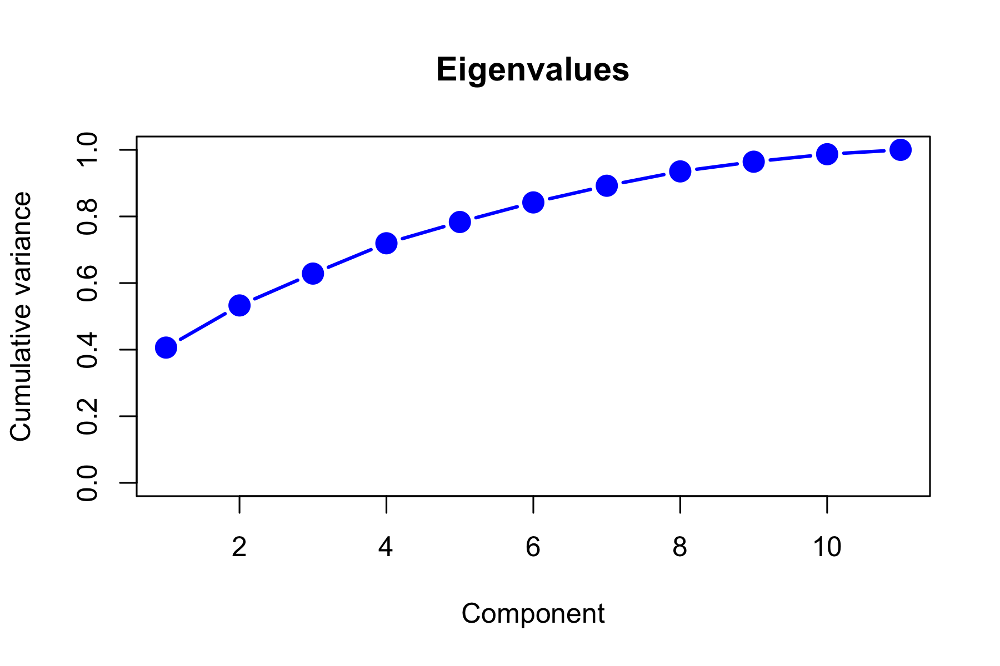

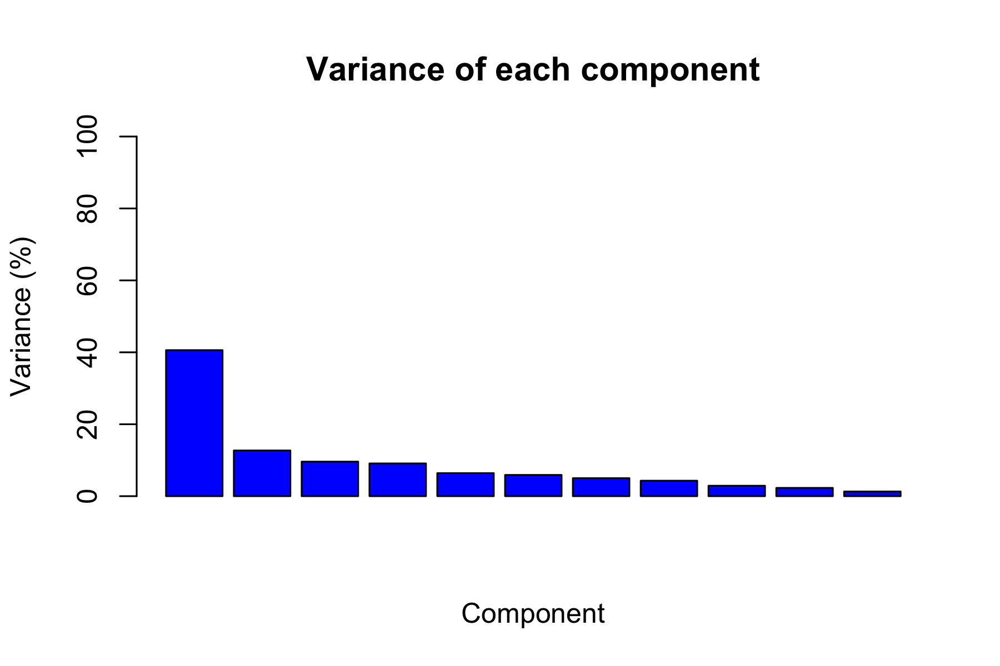

In [35]:
variance <- pr_aptos$sdev^2 / sum(pr_aptos$sdev^2)
plot(cumsum(variance), main = "Eigenvalues", 
     xlab = "Component", ylab = "Cumulative variance", 
     col = "blue", ylim = c(0, 1), type = "b", pch = 19, lwd = 2, 
        cex = 1.5   
)
n <- 5
paste("The sum of variance of the first", n, "components is: ", round(sum(variance[1:n] * 100), 1))
pca_variance <- round(variance * 100, 1)
barplot(pca_variance, main = "Variance of each component", xlab = "Component", ylab = "Variance (%)", 
        col = "blue", ylim = c(0, 100))





In [36]:
library("FactoMineR")
res.pca <- PCA(df_madrid_aptos)
head(res.pca$eig)

,eigenvalue,percentage of variance,cumulative percentage of variance
comp 1,4.4679109,40.617372,40.61737
comp 2,1.3924371,12.658519,53.27589
comp 3,1.0524291,9.567537,62.84343
comp 4,1.0014285,9.103895,71.94732
comp 5,0.7026984,6.388167,78.33549
comp 6,0.6465464,5.877695,84.21318


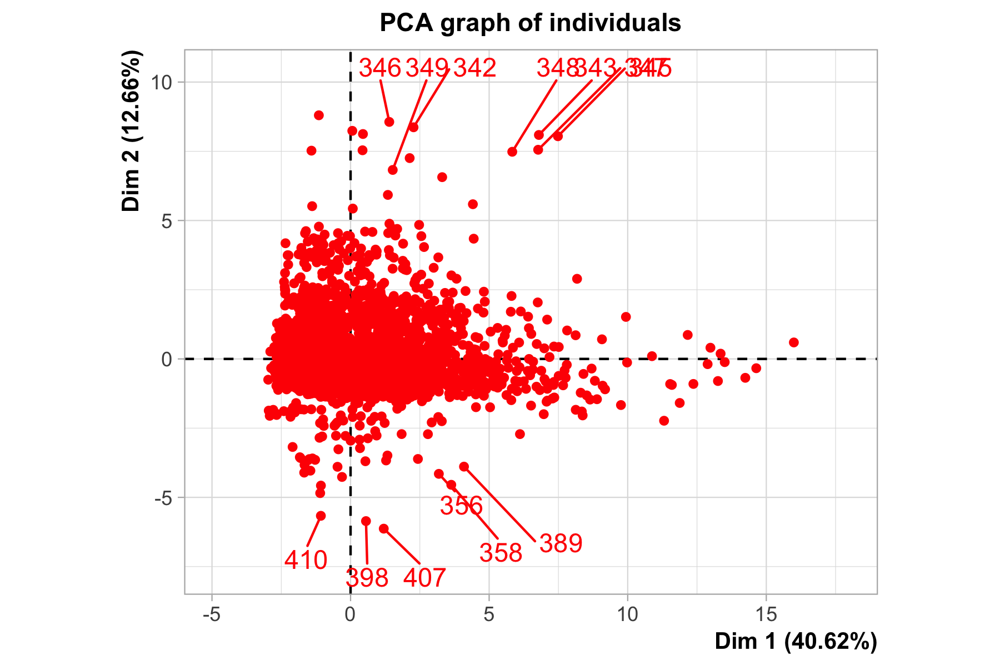

In [37]:

plot(res.pca, choix = "ind", autoLab = "yes", 
# add color 
col.ind = "red"
)

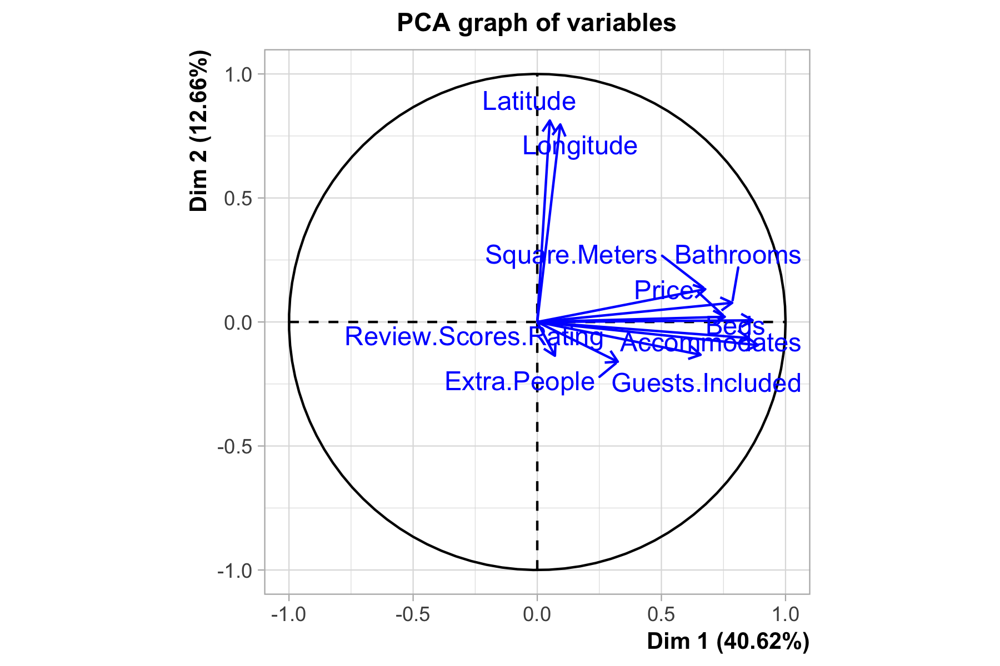

In [38]:
plot(res.pca, choix = "var", autoLab = "yes", 
# add color
col.var = "blue"
)

In [39]:
number_of_components <- 4
similar_apartments <- function(aptos_model, new_apto_data) {
  pca_scores <- predict(aptos_model, new_apto_data)
  pca_scores <- matrix(pca_scores[,1:number_of_components], nrow=1)
  component_data <- aptos_model$x[,1:number_of_components]
  distances <- rep(NA, nrow(component_data))
  for (i in 1:nrow(component_data)) {
    distances[i] <- sum((pca_scores - component_data[i,])^10)
  }

  similar_indices_5 <- sort.list(distances)

  # Sort the list in ascending order to get the top 5 similar apartments
  print("Here are the top 5 similar apartments:")
  df_madrid_aptos[similar_indices_5 %in% 1:5,]
}

similar_apartments(pr_aptos, df_apto_new)


[1] "Here are the top 5 similar apartments:"


,Accommodates,Bathrooms,Bedrooms,Beds,Price,Guests.Included,Extra.People,Review.Scores.Rating,Latitude,Longitude,Square.Meters
,<int>,<dbl>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>
2717,6,1,3,4,75,2,15,95,40.40842,-3.712615,85.13905
3170,4,1,1,2,35,2,5,90,40.42566,-3.705322,49.04566
4384,4,1,1,1,69,2,10,80,40.41930,-3.701554,60.13195
1540,7,1,3,4,100,2,40,96,40.40894,-3.697660,74.97272
2203,6,1,2,3,90,2,15,95,40.42469,-3.696031,74.97272


Bonus: ¿de todas las coordenadas PCA cual es la que mejor permite clasificar por id de barrio?

¿Por qué?

In [40]:
# Load the necessary libraries
library(tidyverse)

# Load the dataset
df <- df_madrid_aptos

# Run PCA on the dataset
pca_result <- prcomp(df)

# Print the summary of the results
summary(pca_result)


Importance of components:
                           PC1     PC2      PC3     PC4     PC5     PC6     PC7
Standard deviation     58.8987 33.7034 11.44777 8.60892 1.91296 0.95631 0.64847
Proportion of Variance  0.7204  0.2359  0.02721 0.01539 0.00076 0.00019 0.00009
Cumulative Proportion   0.7204  0.9563  0.98349 0.99888 0.99964 0.99983 0.99992
                           PC8     PC9    PC10    PC11
Standard deviation     0.52173 0.33318 0.01581 0.01007
Proportion of Variance 0.00006 0.00002 0.00000 0.00000
Cumulative Proportion  0.99998 1.00000 1.00000 1.00000

In [41]:
# apply var function to the each one of pca_result components with for loop
for (i in 1:ncol(pca_result$x)) {
# print PCA Component Number
print(paste("PCA Component", i ,": " ,var(pca_result$x[,i] )))
  
}


[1] "PCA Component 1 :  3469.05348762424"
[1] "PCA Component 2 :  1135.92069948426"
[1] "PCA Component 3 :  131.051389046397"
[1] "PCA Component 4 :  74.1135336916366"
[1] "PCA Component 5 :  3.65942531044876"
[1] "PCA Component 6 :  0.914522602489777"
[1] "PCA Component 7 :  0.420519050803609"
[1] "PCA Component 8 :  0.272199673395846"
[1] "PCA Component 9 :  0.111007804345472"
[1] "PCA Component 10 :  0.000249916960583226"
[1] "PCA Component 11 :  0.000101321426647616"
